## GCN and Gene2Vec EDA

### Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from env.imports import *

/ext3/miniconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
2025-10-07 18:43:56.251994: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-10-07 18:43:57.326595: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-10-07 18:43:57.901030: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-10-07 18:43:57.902182: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instruc

In [3]:
import importlib
import data

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

importlib.reload(sim.sim)
importlib.reload(sim.sim_run)
importlib.reload(models.train_val)
importlib.reload(data.data_utils)
importlib.reload(data.data_load)


<module 'data.data_load' from '/scratch/asr655/neuroinformatics/GeneEx2Conn/data/data_load.py'>

#### Check job specs

In [4]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 4.2%
RAM Usage: 11.4%
Available RAM: 1.3T
Total RAM: 1.5T
52.4G


In [5]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


None
Available GPUs: 1
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.00 GB


In [6]:
print("XGBoost version:", xgboost.__version__)
print("cupy version:", cp.__version__)

GPUtil.getAvailable()

# if a number is seen a GPU is available
GPUtil.getGPUs()

DEVICE_ID_LIST = GPUtil.getFirstAvailable()
DEVICE_ID = DEVICE_ID_LIST[0] # grab first element from list
if DEVICE_ID != None: 
    print('GPU found', DEVICE_ID)
    use_gpu = True

    GPUtil.showUtilization()

XGBoost version: 2.0.3
cupy version: 13.1.0
GPU found 0
| ID | GPU | MEM |
------------------
|  0 |  0% |  0% |


In [7]:
torch.cuda.is_available()

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

### Gene list analysis

In [8]:
absolute_data_path = '/scratch/asr655/neuroinformatics/GeneEx2Conn_data'
AHBA_UKBB_path = absolute_data_path + '/Penn_UKBB_data/AHBA_population_MH/'
genes_data = pd.read_csv(os.path.join(AHBA_UKBB_path, 'AHBA_schaefer456_mean_mirror_interpolate.csv'))
print(genes_data.shape)

(456, 15634)


In [10]:
# Print shapes of gene list
genes_list_1 = pd.read_csv(f"./data/enigma/gene_lists/stable_r1_schaefer_400.txt", header=None)[0].tolist()
genes_list_point2 = pd.read_csv(f"./data/enigma/gene_lists/stable_r0.2_schaefer_400.txt", header=None)[0].tolist()

brain_genes = abagen.fetch_gene_group('brain')
neuron_genes = abagen.fetch_gene_group('neuron')
oligo_genes = abagen.fetch_gene_group('oligodendrocyte')
synaptome_genes = abagen.fetch_gene_group('synaptome')
layers_genes = abagen.fetch_gene_group('layers')
richiardi_genes = pd.read_csv('./data/enigma/gene_lists/richiardi2015.txt', header=None)[0].tolist()
syngo_genes = pd.read_csv('./data/enigma/gene_lists/syngo.txt', header=None)[0].tolist()
all_abagen_genes = set.union(
    set(brain_genes),
    set(neuron_genes),
    set(oligo_genes), 
    set(synaptome_genes),
    set(layers_genes)
)

print(f"Number of genes in genes_list_1: {len(genes_list_1)}")
print(f"Number of genes in genes_list_point2: {len(genes_list_point2)}")
print(f"Number of brain genes: {len(brain_genes)}")
print(f"Number of neuron genes: {len(neuron_genes)}")
print(f"Number of oligodendrocyte genes: {len(oligo_genes)}")
print(f"Number of synaptome genes: {len(synaptome_genes)}")
print(f"Number of layers genes: {len(layers_genes)}")
print(f"Number of richiardi genes: {len(richiardi_genes)}")
print(f"Number of syngo genes: {len(syngo_genes)}")
print(f"Number of all abagen genes: {len(all_abagen_genes)}")

# Load human reference genome
human_refgenome = pd.read_csv(absolute_data_path + '/human_refgenome/human_refgenome_ordered.csv')
ordered_genes = human_refgenome['gene_id'].tolist()

# Get gene2vec embeddings gene list
gene2vec_df = pd.read_csv('/scratch/asr655/neuroinformatics/GeneEx2Conn/data/gene_emb/gene2vec_dim_200_iter_9.txt',
                         sep='\s+',
                         header=None)
gene2vec_genes = gene2vec_df[0].tolist()

# Create dictionary of gene lists
gene_lists_dict = {
    'genes_list_point2': genes_list_point2,
    'brain_genes': brain_genes, 
    'neuron_genes': neuron_genes,
    'oligo_genes': oligo_genes,
    'synaptome_genes': synaptome_genes,
    'layers_genes': layers_genes,
    'richiardi_genes': richiardi_genes,
    'syngo_genes': syngo_genes,
    'all_abagen_genes': list(all_abagen_genes)
}

print("\nChecking gene list overlaps:")
for name, genes in gene_lists_dict.items():
    print(f"\n{name}:")
    
    # First check overlap with AHBA genes (genes_list_1)
    ahba_overlap = [gene for gene in genes if gene in genes_list_1]
    print(f"Step 1 - AHBA overlap: {len(ahba_overlap)} / {len(genes)} ({len(ahba_overlap)/len(genes)*100:.1f}%)")
    
    # From AHBA overlap, check reference genome coverage
    refgenome_overlap = [gene for gene in ahba_overlap if gene in ordered_genes]
    print(f"Step 2 - Reference genome coverage: {len(refgenome_overlap)} / {len(ahba_overlap)} ({len(refgenome_overlap)/len(ahba_overlap)*100:.1f}%)")
    
    # From reference genome overlap, check gene2vec coverage
    gene2vec_overlap = [gene for gene in refgenome_overlap if gene in gene2vec_genes]
    print(f"Step 3 - Gene2vec coverage: {len(gene2vec_overlap)} / {len(refgenome_overlap)} ({len(gene2vec_overlap)/len(refgenome_overlap)*100:.1f}%)")
    
    # Show final number of usable genes after all filters
    print(f"Final usable genes: {len(gene2vec_overlap)} / {len(genes)} ({len(gene2vec_overlap)/len(genes)*100:.1f}%)")




  sep='\s+',



Number of genes in genes_list_1: 15633
Number of genes in genes_list_point2: 7584
Number of brain genes: 2413
Number of neuron genes: 2530
Number of oligodendrocyte genes: 1769
Number of synaptome genes: 1886
Number of layers genes: 46
Number of richiardi genes: 136
Number of syngo genes: 1602
Number of all abagen genes: 6406

Checking gene list overlaps:

genes_list_point2:
Step 1 - AHBA overlap: 7584 / 7584 (100.0%)
Step 2 - Reference genome coverage: 7380 / 7584 (97.3%)
Step 3 - Gene2vec coverage: 6957 / 7380 (94.3%)
Final usable genes: 6957 / 7584 (91.7%)

brain_genes:
Step 1 - AHBA overlap: 1906 / 2413 (79.0%)
Step 2 - Reference genome coverage: 1879 / 1906 (98.6%)
Step 3 - Gene2vec coverage: 1829 / 1879 (97.3%)
Final usable genes: 1829 / 2413 (75.8%)

neuron_genes:
Step 1 - AHBA overlap: 2319 / 2530 (91.7%)
Step 2 - Reference genome coverage: 2291 / 2319 (98.8%)
Step 3 - Gene2vec coverage: 2286 / 2291 (99.8%)
Final usable genes: 2286 / 2530 (90.4%)

oligo_genes:
Step 1 - AHBA ove

In [14]:
# Get gene2vec embeddings for all genes
gene_emb_df = pd.read_csv('/scratch/asr655/neuroinformatics/GeneEx2Conn/data/gene_emb/gene2vec_dim_200_iter_9.txt',
                         sep='\s+',
                         header=None,
                         index_col=0)
gene_emb_df



  sep='\s+',



,1,2,3,4,5,6,7,8,9,10,...,191,192,193,194,195,196,197,198,199,200
0,,,,,,,,,,,,,,,,,,,,,
PLAC4,-0.032111,0.005355,-0.001208,0.392700,0.027191,0.057858,-0.065911,0.256802,0.043661,0.081228,...,0.179668,0.199858,-0.044920,0.095846,0.041332,-0.147439,0.239312,-0.183174,-0.264830,0.104818
RPS2P45,-0.433589,0.383065,0.154259,-0.044726,0.406748,0.089424,0.186105,-0.038986,0.245488,-0.712083,...,0.079383,-0.028575,0.263809,0.177087,-0.015819,0.120731,-0.219403,0.199372,0.101292,-0.054681
C3orf18,0.030009,-0.283322,0.213689,0.084640,-0.012634,-0.288767,-0.004061,-0.089572,0.249219,0.164836,...,0.037768,0.328689,0.064318,0.026143,0.005801,-0.185695,0.067693,-0.246346,-0.120931,0.157672
C6orf226,0.029573,-0.058847,-0.297716,0.257432,0.062723,0.071785,-0.079403,0.420420,0.219320,0.316385,...,0.243931,-0.075696,0.092758,0.093465,-0.191904,-0.286557,-0.140394,-0.159963,-0.223003,0.250665
CISD3,0.148815,-0.100394,0.139844,-0.156749,-0.000815,0.115267,0.101778,0.158580,0.287842,0.049861,...,0.227863,0.086968,0.062115,0.314489,-0.148824,-0.121338,-0.245106,0.247893,-0.034497,0.038109
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
LOC284219,-0.097413,0.206977,0.274137,-0.052645,-0.163830,0.080587,0.147385,-0.081156,-0.100284,0.190910,...,0.516521,-0.356231,0.259438,-0.353476,-0.510408,0.158663,-0.378703,-0.184715,0.041767,0.065761
KRTAP21-1,0.093780,-0.661438,0.342262,-0.742463,-0.402170,0.172066,1.039949,-0.706364,1.170597,-0.120575,...,-0.046443,0.347276,1.131234,0.249182,0.902638,0.147042,0.445153,-0.163675,-0.148416,0.195759
PHBP8,-0.491280,-0.335584,-0.454166,-0.134393,-0.455670,-0.137623,-0.335810,-0.065315,-0.172522,-0.110279,...,0.743257,0.116302,0.027702,-0.351308,0.163348,-0.089611,-0.345655,-0.071142,0.027078,0.223668


In [13]:
from data.data_load import load_transcriptome, load_connectome
import numpy as np
from scipy.stats import pearsonr

# Load functional connectivity matrix
Y_fc = load_connectome(parcellation='S456')

gene_lists = ['0.2', '1', 'brain', 'neuron', 'oligodendrocyte', 'synaptome', 'layers', 'richiardi2015', 'syngo', 'all_abagen', 'lake_shared']

print("Correlating region-region gene expression similarity with functional connectivity:")
for gene_list in gene_lists:
    print(f"\nAnalyzing gene list: {gene_list}")
    try:
        # Load gene expression data
        X, valid_genes = load_transcriptome(parcellation='S456', gene_list=gene_list, sort_genes='refgenome', return_valid_genes=True)
        
        # Remove rows that are all NaN in X
        valid_indices = ~np.isnan(X).all(axis=1)
        X = X[valid_indices]
        
        # Subset Y_fc using same valid indices from X
        Y_fc_subset = Y_fc[valid_indices][:, valid_indices]
        
        # Compute region-region correlation matrix
        X_corr = np.corrcoef(X)
        
        # Flatten upper triangle (excluding diagonal)
        X_corr_flat = X_corr[np.triu_indices_from(X_corr, k=1)]
        Y_fc_flat = Y_fc_subset[np.triu_indices_from(Y_fc_subset, k=1)]
        
        # Compute correlation between flattened matrices
        corr, pval = pearsonr(X_corr_flat, Y_fc_flat)
        
        print(f"Number of genes: {len(valid_genes)}")
        print(f"Correlation with FC: r = {corr:.3f}, p = {pval:.3e}")
        
    except Exception as e:
        print(f"Error processing {gene_list}: {str(e)}")


Correlating region-region gene expression similarity with functional connectivity:

Analyzing gene list: 0.2
Number of genes: 7380
Correlation with FC: r = 0.108, p = 1.135e-264

Analyzing gene list: 1
Number of genes: 15633
Correlation with FC: r = 0.109, p = 1.299e-269

Analyzing gene list: brain
Number of genes: 1879
Correlation with FC: r = 0.105, p = 4.081e-252

Analyzing gene list: neuron
Number of genes: 2291
Correlation with FC: r = 0.105, p = 8.748e-250

Analyzing gene list: oligodendrocyte
Number of genes: 1591
Correlation with FC: r = 0.111, p = 5.606e-282

Analyzing gene list: synaptome
Number of genes: 1718
Correlation with FC: r = 0.104, p = 1.429e-245

Analyzing gene list: layers
Number of genes: 42
Correlation with FC: r = 0.146, p = 0.000e+00

Analyzing gene list: richiardi2015
Number of genes: 105
Correlation with FC: r = 0.171, p = 0.000e+00

Analyzing gene list: syngo
Number of genes: 1504
Correlation with FC: r = 0.106, p = 2.421e-256

Analyzing gene list: all_abag

Gene coexpression network analysis

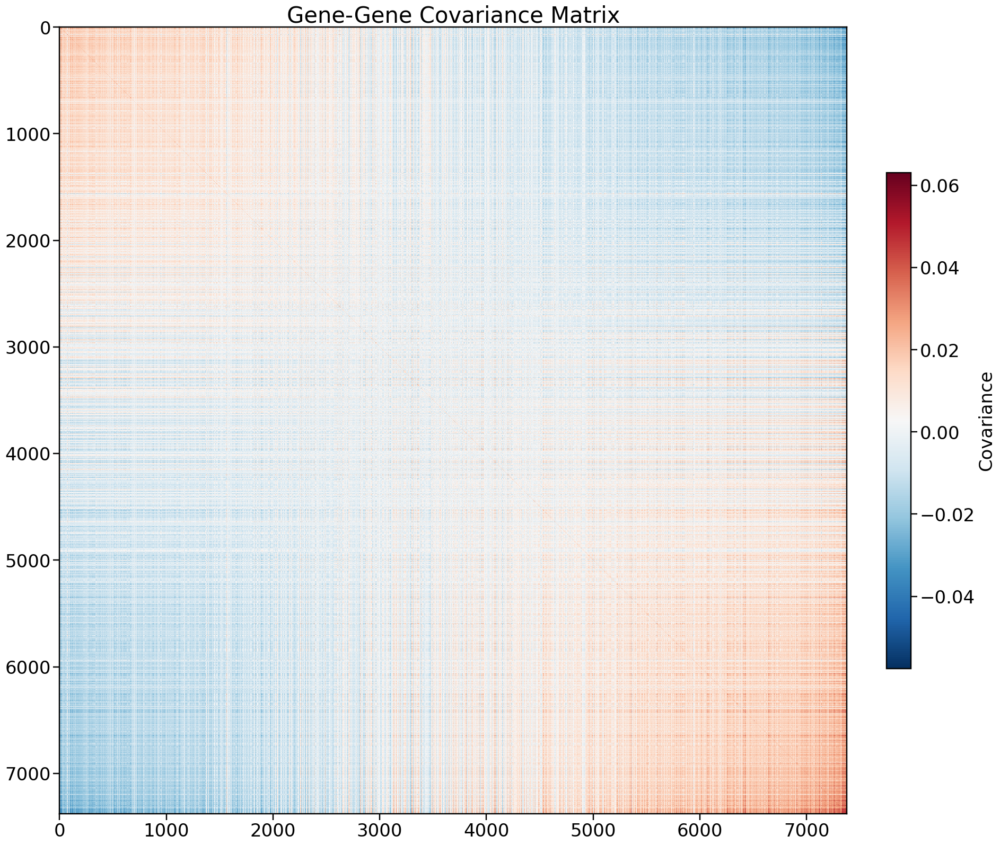

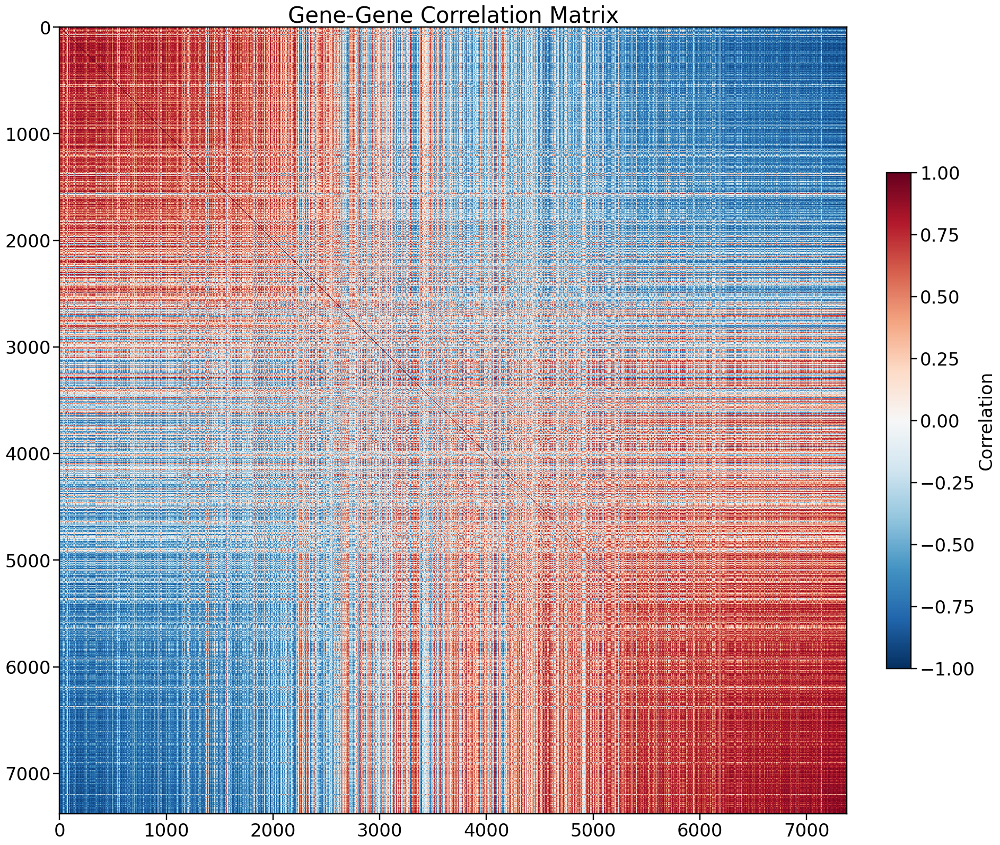

In [16]:
from data.data_load import load_transcriptome
from sklearn.decomposition import PCA

# Load in transcriptome
X, sorted_valid_genes = load_transcriptome(parcellation='S456', gene_list='0.2', sort_genes='expression', return_valid_genes=True)

# Remove rows that are all NaN
valid_indices = ~np.isnan(X).all(axis=1)
X = X[valid_indices]

# mean center
X_centered = X - np.mean(X, axis=0)

# compute covariance matrix
gene_cov = np.cov(X_centered.T)

# imshow covariance matrix with 5-gene binning
fig, ax = plt.subplots(figsize=(20,20), dpi=94, constrained_layout=True)
im = ax.imshow(gene_cov, cmap='RdBu_r', aspect='equal', interpolation='none')
cbar = plt.colorbar(im, label='Covariance', ax=ax, shrink=0.5)
ax.set_title('Gene-Gene Covariance Matrix', fontsize=32)
cbar.ax.tick_params(labelsize=26)
cbar.set_label('Covariance', fontsize=26)
ax.tick_params(axis='both', which='major', labelsize=26)
plt.show()

# imshow correlation matrix with 5-gene binning
corr = np.corrcoef(X_centered.T)
fig, ax = plt.subplots(figsize=(20,20), dpi=94, constrained_layout=True)
im = ax.imshow(corr, cmap='RdBu_r', aspect='equal', vmin=-1, vmax=1, interpolation='none')
cbar = plt.colorbar(im, label='Correlation', ax=ax, shrink=0.5)
ax.set_title('Gene-Gene Correlation Matrix', fontsize=32)
cbar.ax.tick_params(labelsize=26)
cbar.set_label('Correlation', fontsize=26)
ax.tick_params(axis='both', which='major', labelsize=26)
plt.show()

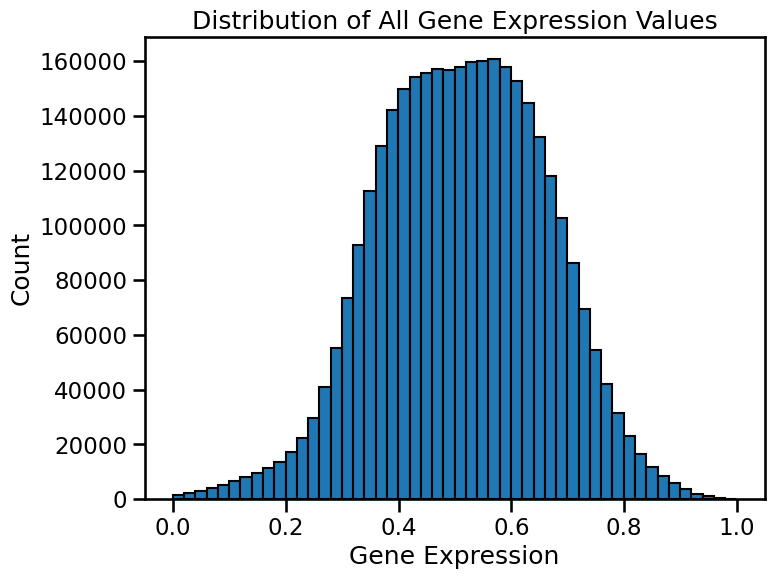

In [17]:
# Plot distribution of all gene expression values
plt.figure(figsize=(8,6))
plt.hist(X.flatten(), bins=50, edgecolor='black')
plt.xlabel('Gene Expression')
plt.ylabel('Count')
plt.title('Distribution of All Gene Expression Values')
plt.show()

(7380,)


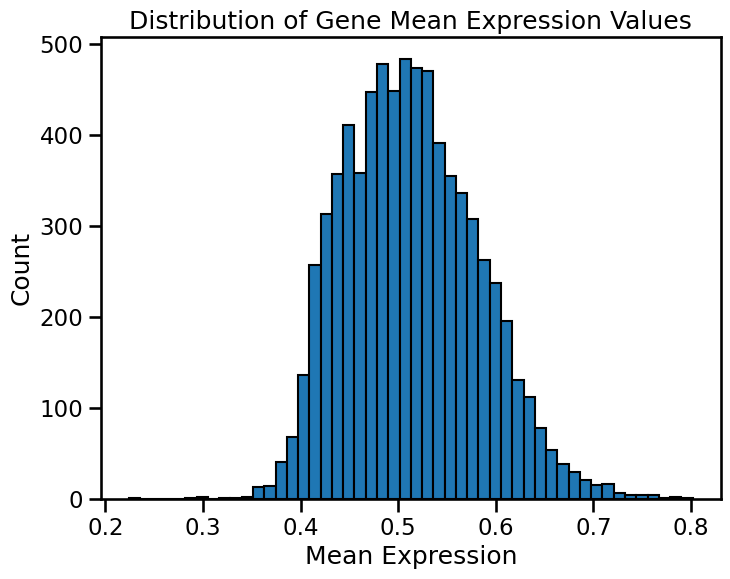

In [18]:
# Calculate mean expression for each gene
gene_means = np.mean(X, axis=0)
print(gene_means.shape)

plt.figure(figsize=(8,6))
plt.hist(gene_means, bins=50, edgecolor='black')
plt.xlabel('Mean Expression')
plt.ylabel('Count')
plt.title('Distribution of Gene Mean Expression Values')
plt.show()

KMeans

In [11]:
from sklearn.cluster import KMeans
# Suppress threadpoolctl warnings
import warnings
warnings.filterwarnings('ignore', category=UserWarning)

# Create dictionary to store k-means solutions and models
k_means = {}
k_means_models = {}

# Z-score the correlation matrix once since it's the same for all k
corr_zscore = (corr - np.mean(corr)) / np.std(corr)

# Fit k-means for different k values
for k in [3, 4, 10, 41, 123, 246, 369]:
    # Initialize and fit k-means
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(corr_zscore)
    
    # Store both the model and labels
    k_means_models[k] = kmeans
    k_means[k] = kmeans.labels_
    
    print(f"Completed clustering for k={k}")

Exception ignored on calling ctypes callback function: <function _ThreadpoolInfo._find_modules_with_dl_iterate_phdr.<locals>.match_module_callback at 0x7fd9e8577740>
Traceback (most recent call last):
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 400, in match_module_callback
    self._make_module_from_path(filepath)
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 515, in _make_module_from_path
    module = module_class(filepath, prefix, user_api, internal_api)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 606, in __init__
    self.version = self.get_version()
                   ^^^^^^^^^^^^^^^^^^
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 646, in get_version
    config = get_config().split()
             ^^^^^^^^^^^^^^^^^^
AttributeError: 'NoneType' object has no attribute 'split'
Exception 

Exception ignored on calling ctypes callback function: <function _ThreadpoolInfo._find_modules_with_dl_iterate_phdr.<locals>.match_module_callback at 0x7fd9e8577740>
Traceback (most recent call last):
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 400, in match_module_callback
    self._make_module_from_path(filepath)
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 515, in _make_module_from_path
    module = module_class(filepath, prefix, user_api, internal_api)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 606, in __init__
    self.version = self.get_version()
                   ^^^^^^^^^^^^^^^^^^
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 646, in get_version
    config = get_config().split()
             ^^^^^^^^^^^^^^^^^^
AttributeError: 'NoneType' object has no attribute 'split'


Completed clustering for k=3


Exception ignored on calling ctypes callback function: <function _ThreadpoolInfo._find_modules_with_dl_iterate_phdr.<locals>.match_module_callback at 0x7fd9e8f00400>
Traceback (most recent call last):
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 400, in match_module_callback
    self._make_module_from_path(filepath)
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 515, in _make_module_from_path
    module = module_class(filepath, prefix, user_api, internal_api)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 606, in __init__
    self.version = self.get_version()
                   ^^^^^^^^^^^^^^^^^^
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 646, in get_version
    config = get_config().split()
             ^^^^^^^^^^^^^^^^^^
AttributeError: 'NoneType' object has no attribute 'split'
Exception 

Completed clustering for k=4


Exception ignored on calling ctypes callback function: <function _ThreadpoolInfo._find_modules_with_dl_iterate_phdr.<locals>.match_module_callback at 0x7fd9e8f00680>
Traceback (most recent call last):
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 400, in match_module_callback
    self._make_module_from_path(filepath)
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 515, in _make_module_from_path
    module = module_class(filepath, prefix, user_api, internal_api)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 606, in __init__
    self.version = self.get_version()
                   ^^^^^^^^^^^^^^^^^^
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 646, in get_version
    config = get_config().split()
             ^^^^^^^^^^^^^^^^^^
AttributeError: 'NoneType' object has no attribute 'split'
Exception 

Completed clustering for k=10


Exception ignored on calling ctypes callback function: <function _ThreadpoolInfo._find_modules_with_dl_iterate_phdr.<locals>.match_module_callback at 0x7fd9e8f00540>
Traceback (most recent call last):
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 400, in match_module_callback
    self._make_module_from_path(filepath)
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 515, in _make_module_from_path
    module = module_class(filepath, prefix, user_api, internal_api)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 606, in __init__
    self.version = self.get_version()
                   ^^^^^^^^^^^^^^^^^^
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 646, in get_version
    config = get_config().split()
             ^^^^^^^^^^^^^^^^^^
AttributeError: 'NoneType' object has no attribute 'split'
Exception 

Completed clustering for k=41


Exception ignored on calling ctypes callback function: <function _ThreadpoolInfo._find_modules_with_dl_iterate_phdr.<locals>.match_module_callback at 0x7fd9e8f004a0>
Traceback (most recent call last):
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 400, in match_module_callback
    self._make_module_from_path(filepath)
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 515, in _make_module_from_path
    module = module_class(filepath, prefix, user_api, internal_api)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 606, in __init__
    self.version = self.get_version()
                   ^^^^^^^^^^^^^^^^^^
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 646, in get_version
    config = get_config().split()
             ^^^^^^^^^^^^^^^^^^
AttributeError: 'NoneType' object has no attribute 'split'
Exception 

Completed clustering for k=123


Exception ignored on calling ctypes callback function: <function _ThreadpoolInfo._find_modules_with_dl_iterate_phdr.<locals>.match_module_callback at 0x7fd9e8f00680>
Traceback (most recent call last):
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 400, in match_module_callback
    self._make_module_from_path(filepath)
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 515, in _make_module_from_path
    module = module_class(filepath, prefix, user_api, internal_api)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 606, in __init__
    self.version = self.get_version()
                   ^^^^^^^^^^^^^^^^^^
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 646, in get_version
    config = get_config().split()
             ^^^^^^^^^^^^^^^^^^
AttributeError: 'NoneType' object has no attribute 'split'
Exception 

Completed clustering for k=246


Exception ignored on calling ctypes callback function: <function _ThreadpoolInfo._find_modules_with_dl_iterate_phdr.<locals>.match_module_callback at 0x7fd9e8577740>
Traceback (most recent call last):
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 400, in match_module_callback
    self._make_module_from_path(filepath)
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 515, in _make_module_from_path
    module = module_class(filepath, prefix, user_api, internal_api)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 606, in __init__
    self.version = self.get_version()
                   ^^^^^^^^^^^^^^^^^^
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 646, in get_version
    config = get_config().split()
             ^^^^^^^^^^^^^^^^^^
AttributeError: 'NoneType' object has no attribute 'split'
Exception 

Completed clustering for k=369


In [12]:
from sklearn.cluster import KMeans
from scipy.optimize import linear_sum_assignment
from sklearn.metrics import pairwise_distances

def greedy_kmeans_clustering(kmeans_model, corr_zscore, gene_means, n_clusters):
    """
    Performs greedy k-means clustering with even-sized clusters, sorted by mean expression.
    
    Parameters:
    -----------
    kmeans_model : sklearn.cluster.KMeans
        Fitted k-means model
    corr_zscore : np.ndarray
        Z-scored correlation matrix
    gene_means : np.ndarray
        Mean expression values for each gene
    n_clusters : int
        Number of clusters
        
    Returns:
    --------
    sorted_indices : np.ndarray
        Indices that sort genes into even clusters
    cluster_boundaries : list
        Boundaries between clusters in sorted order
    cluster_labels : np.ndarray 
        Cluster assignments for each gene
    cluster_size : int
        Size of each cluster
    """
    # Get distances to cluster centers for reassignment
    distances = kmeans_model.transform(corr_zscore)

    # Initialize even-sized cluster labels
    cluster_size = int(len(gene_means) / n_clusters)  # Calculate target cluster size
    cluster_labels = np.full(len(gene_means), -1)

    # First sort clusters by their mean expression
    cluster_mean_expressions = []
    for cluster in range(n_clusters):
        cluster_mask = kmeans_model.labels_ == cluster
        cluster_mean = np.mean(gene_means[cluster_mask])
        cluster_mean_expressions.append(cluster_mean)

    # Get sorted order of clusters
    cluster_order = np.argsort(-np.array(cluster_mean_expressions))

    # Sort within each cluster by mean expression
    initial_sorted_indices = []
    for cluster_idx in cluster_order:
        # Get genes in this cluster
        cluster_mask = kmeans_model.labels_ == cluster_idx
        cluster_genes = np.where(cluster_mask)[0]
        
        # Sort genes by mean expression within cluster
        cluster_genes = cluster_genes[cluster_genes < len(gene_means)]
        if len(cluster_genes) > 0:
            cluster_means = gene_means[cluster_genes]
            sorted_cluster = cluster_genes[np.argsort(-cluster_means)]  # - for descending order
            initial_sorted_indices.extend(sorted_cluster)

    # Convert to array
    initial_sorted_indices = np.array(initial_sorted_indices)

    # Now reassign points to clusters in sorted cluster order
    for i, cluster in enumerate(cluster_order):
        # Find points that haven't been assigned to a cluster yet
        mask = cluster_labels == -1
        
        # Get distances from unassigned points to current cluster center
        dist_to_cluster = distances[mask, cluster]
        
        # Find indices of cluster_size closest points to this cluster center
        closest_indices = np.argpartition(dist_to_cluster, min(cluster_size - 1, len(dist_to_cluster)-1))[:cluster_size]
        
        # Convert masked indices back to original array indices
        unassigned_indices = np.where(mask)[0]
        points_to_assign = unassigned_indices[closest_indices]
        
        # Sort points within cluster by mean expression
        cluster_means = gene_means[points_to_assign]
        sorted_points = points_to_assign[np.argsort(-cluster_means)]
        
        # Assign the cluster_size closest points to current cluster
        cluster_labels[sorted_points] = i

    # Get final indices sorted by cluster assignment and mean expression
    sorted_indices = []
    cluster_boundaries = [0]  # Track cluster boundaries
    for cluster in range(n_clusters):
        cluster_mask = cluster_labels == cluster
        cluster_genes = np.where(cluster_mask)[0]
        cluster_means = gene_means[cluster_genes]
        sorted_cluster = cluster_genes[np.argsort(-cluster_means)]
        sorted_indices.extend(sorted_cluster)
        cluster_boundaries.append(cluster_boundaries[-1] + len(sorted_cluster))

    sorted_indices = np.array(sorted_indices)
    
    return sorted_indices, cluster_boundaries, cluster_labels, cluster_size
    
def balanced_kmeans_hungarian(X, n_clusters=128, random_state=42, distance_metric='euclidean'):
    """
    Performs balanced k-means clustering using the Hungarian algorithm to enforce equal-sized clusters.

    Parameters:
    -----------
    X : np.ndarray
        Input data of shape (n_samples, n_features)
    n_clusters : int
        Number of balanced clusters to generate
    random_state : int
        Random seed
    distance_metric : str
        Distance metric to use for pairwise distances (e.g. 'euclidean', 'cosine')

    Returns:
    --------
    cluster_assignments : np.ndarray
        Cluster label (0 to n_clusters-1) for each sample
    sorted_indices : np.ndarray
        Indices of samples sorted by cluster then by assignment order
    """

    n_samples = X.shape[0]
    assert n_samples % n_clusters == 0, "Number of samples must be divisible by number of clusters"

    samples_per_cluster = n_samples // n_clusters

    # Step 1: Run initial KMeans to get centroids
    kmeans = KMeans(n_clusters=n_clusters, random_state=random_state, n_init='auto')
    kmeans.fit(X)
    centroids = kmeans.cluster_centers_

    # Step 2: Compute cost matrix (n_samples, n_clusters)
    cost = pairwise_distances(X, centroids, metric=distance_metric)  # shape (n_samples, n_clusters)

    # Step 3: Expand each cluster into `samples_per_cluster` slots
    expanded_cost = np.repeat(cost, samples_per_cluster, axis=1)  # shape (n_samples, n_clusters * size)

    # Step 4: Solve assignment problem
    row_ind, col_ind = linear_sum_assignment(expanded_cost)

    # Step 5: Convert column index back to cluster index
    cluster_assignments = col_ind // samples_per_cluster

    # Step 6: Sort indices by cluster assignment (for reordering matrices, etc.)
    sorted_indices = np.argsort(cluster_assignments)

    return cluster_assignments, sorted_indices

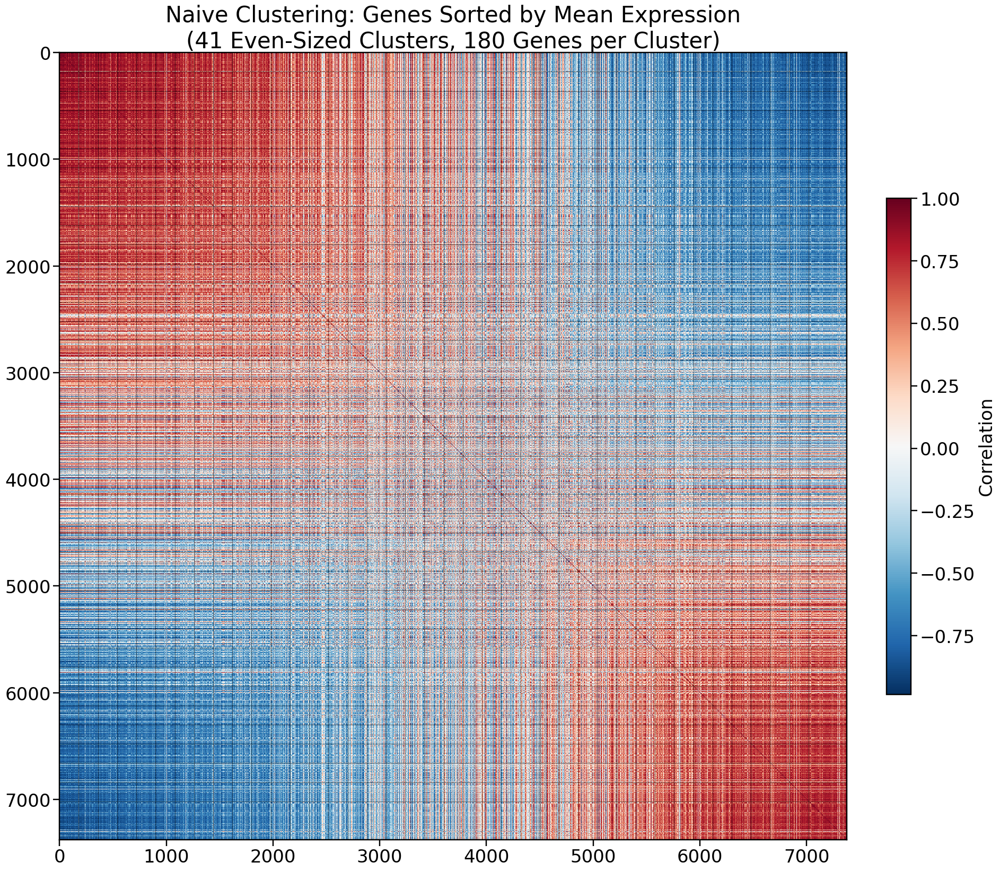

Exception ignored on calling ctypes callback function: <function _ThreadpoolInfo._find_modules_with_dl_iterate_phdr.<locals>.match_module_callback at 0x7fd9e8f016c0>
Traceback (most recent call last):
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 400, in match_module_callback
    self._make_module_from_path(filepath)
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 515, in _make_module_from_path
    module = module_class(filepath, prefix, user_api, internal_api)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 606, in __init__
    self.version = self.get_version()
                   ^^^^^^^^^^^^^^^^^^
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 646, in get_version
    config = get_config().split()
             ^^^^^^^^^^^^^^^^^^
AttributeError: 'NoneType' object has no attribute 'split'


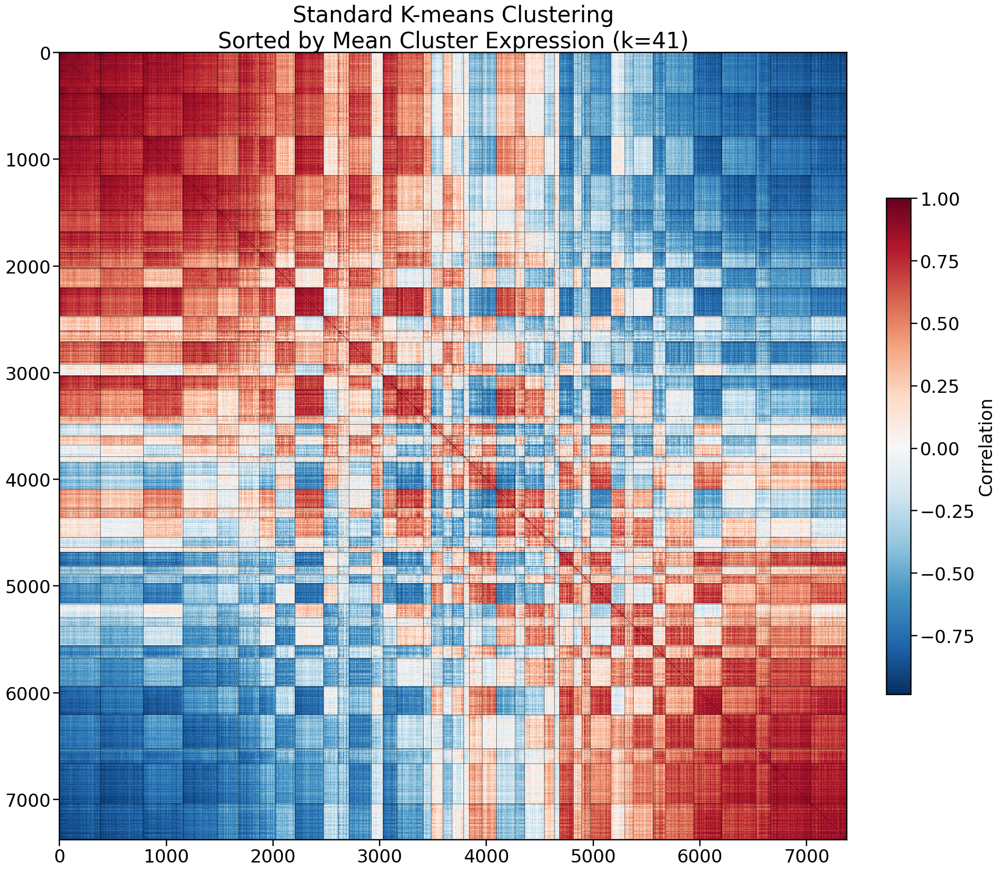

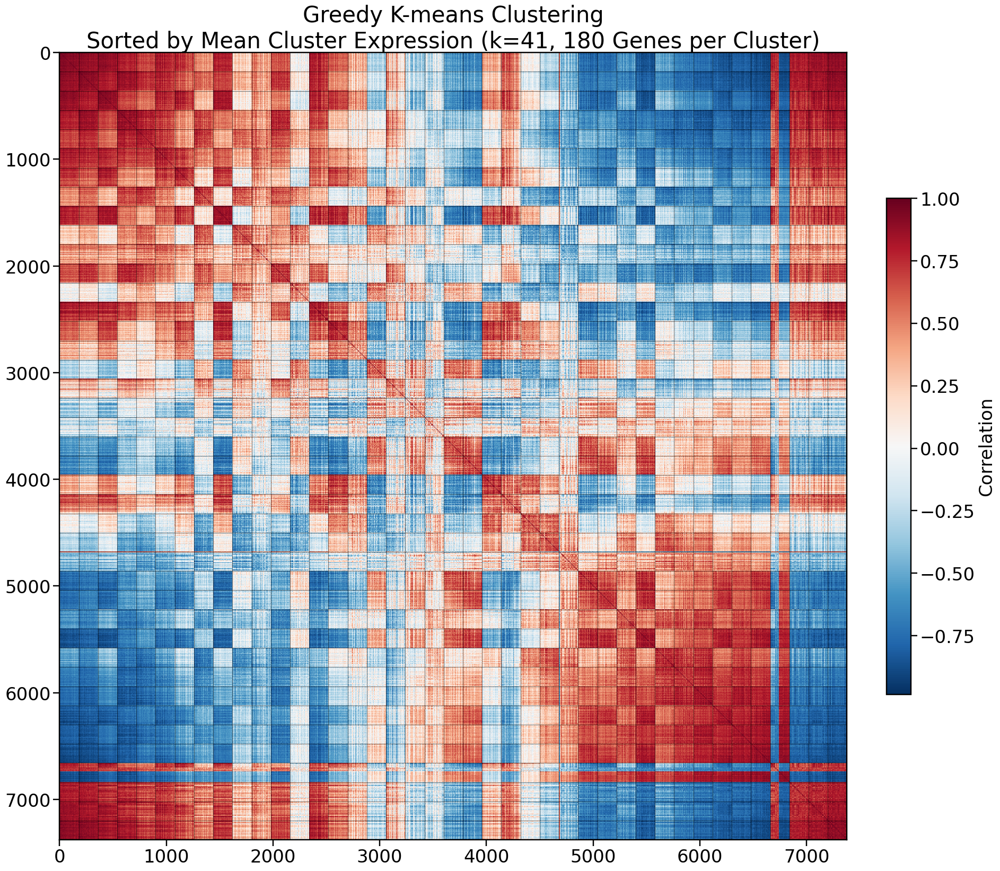

Exception ignored on calling ctypes callback function: <function _ThreadpoolInfo._find_modules_with_dl_iterate_phdr.<locals>.match_module_callback at 0x7fd9e95bbec0>
Traceback (most recent call last):
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 400, in match_module_callback
    self._make_module_from_path(filepath)
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 515, in _make_module_from_path
    module = module_class(filepath, prefix, user_api, internal_api)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 606, in __init__
    self.version = self.get_version()
                   ^^^^^^^^^^^^^^^^^^
  File "/ext3/miniconda3/lib/python3.11/site-packages/threadpoolctl.py", line 646, in get_version
    config = get_config().split()
             ^^^^^^^^^^^^^^^^^^
AttributeError: 'NoneType' object has no attribute 'split'


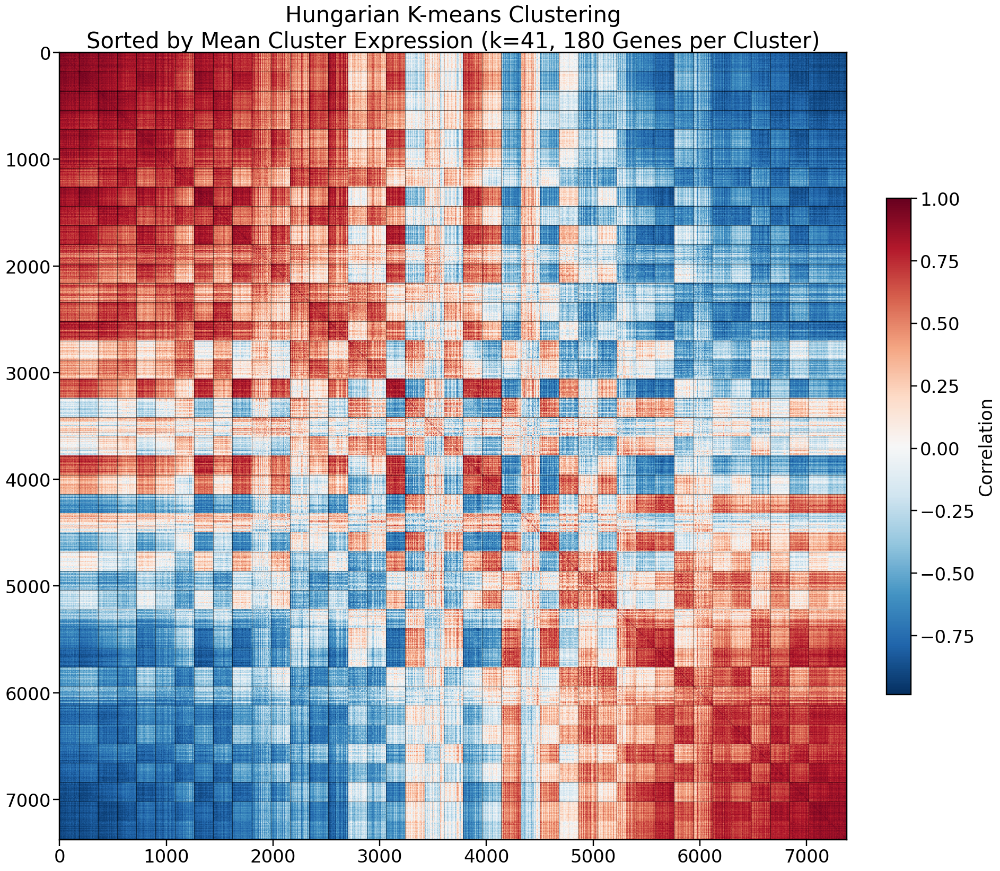

In [13]:
# Silence warnings
import warnings
warnings.filterwarnings('ignore')

# Global plotting parameters
FIGSIZE = (20,20)
DPI = 94
FONTSIZE = 32
TICK_FONTSIZE = 26
CMAP = 'RdBu_r'
LINE_ALPHA = 0.5
LINE_WIDTH = 0.8

# Clustering parameters
n_clusters = 41  # Number of clusters desired
n_genes = corr.shape[0]
cluster_size = n_genes // n_clusters  # Size of each cluster

# 1. Naive clustering - sort by mean expression and split into even bins
sorted_by_mean = np.argsort(-gene_means)  # Descending order
corr_mean_sorted = corr[sorted_by_mean][:, sorted_by_mean]

fig, ax = plt.subplots(figsize=FIGSIZE, dpi=DPI, constrained_layout=True)
im = ax.imshow(corr_mean_sorted, cmap=CMAP, aspect='equal', interpolation='none')

boundaries = np.arange(0, n_genes, cluster_size)
for boundary in boundaries[1:-1]:
    ax.axhline(y=boundary-0.5, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)
    ax.axvline(x=boundary-0.5, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)

cbar = plt.colorbar(im, label='Correlation', ax=ax, shrink=0.5)
ax.set_title(f'Naive Clustering: Genes Sorted by Mean Expression\n({n_clusters} Even-Sized Clusters, {cluster_size} Genes per Cluster)', fontsize=FONTSIZE)
cbar.ax.tick_params(labelsize=TICK_FONTSIZE)
cbar.set_label('Correlation', fontsize=TICK_FONTSIZE)
ax.tick_params(axis='both', which='major', labelsize=TICK_FONTSIZE)
plt.show()

# 2. Standard K-means clustering
kmeans_model = k_means_models[n_clusters]
initial_labels = kmeans_model.predict(corr_zscore)

# Calculate and sort clusters by mean expression
cluster_means = [np.mean(gene_means[initial_labels == i]) for i in range(n_clusters)]
cluster_order = np.argsort(-np.array(cluster_means))

# Sort genes within clusters
sorted_indices = []
cluster_boundaries = [0]
for cluster_idx in cluster_order:
    cluster_mask = initial_labels == cluster_idx
    cluster_genes = np.where(cluster_mask)[0]
    sorted_indices.extend(cluster_genes[np.argsort(-gene_means[cluster_genes])])
    cluster_boundaries.append(cluster_boundaries[-1] + len(cluster_genes))

fig, ax = plt.subplots(figsize=FIGSIZE, dpi=DPI, constrained_layout=True)
corr_kmeans = corr[sorted_indices][:, sorted_indices]
im = ax.imshow(corr_kmeans, cmap=CMAP, aspect='equal', interpolation='none')

for boundary in cluster_boundaries[1:-1]:
    ax.axhline(y=boundary, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)
    ax.axvline(x=boundary, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)

cbar = plt.colorbar(im, label='Correlation', ax=ax, shrink=0.5)
ax.set_title(f'Standard K-means Clustering\nSorted by Mean Cluster Expression (k={n_clusters})', fontsize=FONTSIZE)
cbar.ax.tick_params(labelsize=TICK_FONTSIZE)
cbar.set_label('Correlation', fontsize=TICK_FONTSIZE)
ax.tick_params(axis='both', which='major', labelsize=TICK_FONTSIZE)
plt.show()

# 3. Greedy K-means clustering
sorted_indices, cluster_boundaries, _, _ = greedy_kmeans_clustering(
    kmeans_model, corr_zscore, gene_means, n_clusters
)

fig, ax = plt.subplots(figsize=FIGSIZE, dpi=DPI, constrained_layout=True)
corr_greedy = corr[sorted_indices][:, sorted_indices]
im = ax.imshow(corr_greedy, cmap=CMAP, aspect='equal', interpolation='none')

for boundary in cluster_boundaries[1:-1]:
    ax.axhline(y=boundary, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)
    ax.axvline(x=boundary, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)

cbar = plt.colorbar(im, label='Correlation', ax=ax, shrink=0.5)
ax.set_title(f'Greedy K-means Clustering\nSorted by Mean Cluster Expression (k={n_clusters}, {cluster_size} Genes per Cluster)', fontsize=FONTSIZE)
cbar.ax.tick_params(labelsize=TICK_FONTSIZE)
cbar.set_label('Correlation', fontsize=TICK_FONTSIZE)
ax.tick_params(axis='both', which='major', labelsize=TICK_FONTSIZE)
plt.show()

# 4. Hungarian K-means clustering
cluster_assignments, sorted_indices = balanced_kmeans_hungarian(
    corr,
    n_clusters=n_clusters,
    random_state=42,
    distance_metric='euclidean'
)

# Sort clusters by mean expression
cluster_means = [np.mean(gene_means[cluster_assignments == i]) for i in range(n_clusters)]
cluster_order = np.argsort(-np.array(cluster_means))

# Sort within clusters
final_sorted_indices = []
for cluster_idx in cluster_order:
    cluster_mask = cluster_assignments == cluster_idx
    cluster_genes = np.where(cluster_mask)[0]
    final_sorted_indices.extend(cluster_genes[np.argsort(-gene_means[cluster_genes])])

fig, ax = plt.subplots(figsize=FIGSIZE, dpi=DPI, constrained_layout=True)
corr_hungarian = corr[final_sorted_indices][:, final_sorted_indices]
im = ax.imshow(corr_hungarian, cmap=CMAP, aspect='equal', interpolation='none')

boundaries = np.arange(0, n_genes, cluster_size)
for boundary in boundaries[1:-1]:
    ax.axhline(y=boundary, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)
    ax.axvline(x=boundary, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)

cbar = plt.colorbar(im, label='Correlation', ax=ax, shrink=0.5)
ax.set_title(f'Hungarian K-means Clustering\nSorted by Mean Cluster Expression (k={n_clusters}, {cluster_size} Genes per Cluster)', fontsize=FONTSIZE)
cbar.ax.tick_params(labelsize=TICK_FONTSIZE)
cbar.set_label('Correlation', fontsize=TICK_FONTSIZE)
ax.tick_params(axis='both', which='major', labelsize=TICK_FONTSIZE)
plt.show()

sorted_valid_genes_41 = [sorted_valid_genes[i] for i in final_sorted_indices]

In [11]:
'''
# Silence warnings
import warnings
warnings.filterwarnings('ignore')

# Global plotting parameters
FIGSIZE = (20,20)
DPI = 94
FONTSIZE = 32
TICK_FONTSIZE = 26
CMAP = 'RdBu_r'
LINE_ALPHA = 0.5
LINE_WIDTH = 0.8

# Clustering parameters
n_clusters = 123  # Number of clusters desired
n_genes = corr.shape[0]
cluster_size = n_genes // n_clusters  # Size of each cluster

# 1. Naive clustering - sort by mean expression and split into even bins
sorted_by_mean = np.argsort(-gene_means)  # Descending order
corr_mean_sorted = corr[sorted_by_mean][:, sorted_by_mean]

fig, ax = plt.subplots(figsize=FIGSIZE, dpi=DPI, constrained_layout=True)
im = ax.imshow(corr_mean_sorted, cmap=CMAP, aspect='equal', interpolation='none')

boundaries = np.arange(0, n_genes, cluster_size)
for boundary in boundaries[1:-1]:
    ax.axhline(y=boundary-0.5, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)
    ax.axvline(x=boundary-0.5, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)

cbar = plt.colorbar(im, label='Correlation', ax=ax, shrink=0.5)
ax.set_title(f'Naive Clustering: Genes Sorted by Mean Expression\n({n_clusters} Even-Sized Clusters, {cluster_size} Genes per Cluster)', fontsize=FONTSIZE)
cbar.ax.tick_params(labelsize=TICK_FONTSIZE)
cbar.set_label('Correlation', fontsize=TICK_FONTSIZE)
ax.tick_params(axis='both', which='major', labelsize=TICK_FONTSIZE)
plt.show()

# 2. Standard K-means clustering
kmeans_model = k_means_models[n_clusters]
initial_labels = kmeans_model.predict(corr_zscore)

# Calculate and sort clusters by mean expression
cluster_means = [np.mean(gene_means[initial_labels == i]) for i in range(n_clusters)]
cluster_order = np.argsort(-np.array(cluster_means))

# Sort genes within clusters
sorted_indices = []
cluster_boundaries = [0]
for cluster_idx in cluster_order:
    cluster_mask = initial_labels == cluster_idx
    cluster_genes = np.where(cluster_mask)[0]
    sorted_indices.extend(cluster_genes[np.argsort(-gene_means[cluster_genes])])
    cluster_boundaries.append(cluster_boundaries[-1] + len(cluster_genes))

fig, ax = plt.subplots(figsize=FIGSIZE, dpi=DPI, constrained_layout=True)
corr_kmeans = corr[sorted_indices][:, sorted_indices]
im = ax.imshow(corr_kmeans, cmap=CMAP, aspect='equal', interpolation='none')

for boundary in cluster_boundaries[1:-1]:
    ax.axhline(y=boundary, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)
    ax.axvline(x=boundary, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)

cbar = plt.colorbar(im, label='Correlation', ax=ax, shrink=0.5)
ax.set_title(f'Standard K-means Clustering\nSorted by Mean Cluster Expression (k={n_clusters})', fontsize=FONTSIZE)
cbar.ax.tick_params(labelsize=TICK_FONTSIZE)
cbar.set_label('Correlation', fontsize=TICK_FONTSIZE)
ax.tick_params(axis='both', which='major', labelsize=TICK_FONTSIZE)
plt.show()

# 3. Greedy K-means clustering
sorted_indices, cluster_boundaries, _, _ = greedy_kmeans_clustering(
    kmeans_model, corr_zscore, gene_means, n_clusters
)

fig, ax = plt.subplots(figsize=FIGSIZE, dpi=DPI, constrained_layout=True)
corr_greedy = corr[sorted_indices][:, sorted_indices]
im = ax.imshow(corr_greedy, cmap=CMAP, aspect='equal', interpolation='none')

for boundary in cluster_boundaries[1:-1]:
    ax.axhline(y=boundary, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)
    ax.axvline(x=boundary, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)

cbar = plt.colorbar(im, label='Correlation', ax=ax, shrink=0.5)
ax.set_title(f'Greedy K-means Clustering\nSorted by Mean Cluster Expression (k={n_clusters}, {cluster_size} Genes per Cluster)', fontsize=FONTSIZE)
cbar.ax.tick_params(labelsize=TICK_FONTSIZE)
cbar.set_label('Correlation', fontsize=TICK_FONTSIZE)
ax.tick_params(axis='both', which='major', labelsize=TICK_FONTSIZE)
plt.show()

# 4. Hungarian K-means clustering
cluster_assignments, sorted_indices = balanced_kmeans_hungarian(
    corr,
    n_clusters=n_clusters,
    random_state=42,
    distance_metric='euclidean'
)

# Sort clusters by mean expression
cluster_means = [np.mean(gene_means[cluster_assignments == i]) for i in range(n_clusters)]
cluster_order = np.argsort(-np.array(cluster_means))

# Sort within clusters
final_sorted_indices = []
for cluster_idx in cluster_order:
    cluster_mask = cluster_assignments == cluster_idx
    cluster_genes = np.where(cluster_mask)[0]
    final_sorted_indices.extend(cluster_genes[np.argsort(-gene_means[cluster_genes])])

fig, ax = plt.subplots(figsize=FIGSIZE, dpi=DPI, constrained_layout=True)
corr_hungarian = corr[final_sorted_indices][:, final_sorted_indices]
im = ax.imshow(corr_hungarian, cmap=CMAP, aspect='equal', interpolation='none')

boundaries = np.arange(0, n_genes, cluster_size)
for boundary in boundaries[1:-1]:
    ax.axhline(y=boundary, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)
    ax.axvline(x=boundary, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)

cbar = plt.colorbar(im, label='Correlation', ax=ax, shrink=0.5)
ax.set_title(f'Hungarian K-means Clustering\nSorted by Mean Cluster Expression (k={n_clusters}, {cluster_size} Genes per Cluster)', fontsize=FONTSIZE)
cbar.ax.tick_params(labelsize=TICK_FONTSIZE)
cbar.set_label('Correlation', fontsize=TICK_FONTSIZE)
ax.tick_params(axis='both', which='major', labelsize=TICK_FONTSIZE)
plt.show()

sorted_valid_genes_123 = [sorted_valid_genes[i] for i in final_sorted_indices]
'''

"\n# Silence warnings\nimport warnings\nwarnings.filterwarnings('ignore')\n\n# Global plotting parameters\nFIGSIZE = (20,20)\nDPI = 94\nFONTSIZE = 32\nTICK_FONTSIZE = 26\nCMAP = 'RdBu_r'\nLINE_ALPHA = 0.5\nLINE_WIDTH = 0.8\n\n# Clustering parameters\nn_clusters = 123  # Number of clusters desired\nn_genes = corr.shape[0]\ncluster_size = n_genes // n_clusters  # Size of each cluster\n\n# 1. Naive clustering - sort by mean expression and split into even bins\nsorted_by_mean = np.argsort(-gene_means)  # Descending order\ncorr_mean_sorted = corr[sorted_by_mean][:, sorted_by_mean]\n\nfig, ax = plt.subplots(figsize=FIGSIZE, dpi=DPI, constrained_layout=True)\nim = ax.imshow(corr_mean_sorted, cmap=CMAP, aspect='equal', interpolation='none')\n\nboundaries = np.arange(0, n_genes, cluster_size)\nfor boundary in boundaries[1:-1]:\n    ax.axhline(y=boundary-0.5, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)\n    ax.axvline(x=boundary-0.5, color='black', alpha=LINE_ALPHA, linewidth=LINE_WID

In [12]:
'''
# Silence warnings
import warnings
warnings.filterwarnings('ignore')

# Global plotting parameters
FIGSIZE = (20,20)
DPI = 94
FONTSIZE = 32
TICK_FONTSIZE = 26
CMAP = 'RdBu_r'
LINE_ALPHA = 0.5
LINE_WIDTH = 0.8

# Clustering parameters
n_clusters = 369  # Number of clusters desired
n_genes = corr.shape[0]
cluster_size = n_genes // n_clusters  # Size of each cluster

# 1. Naive clustering - sort by mean expression and split into even bins
sorted_by_mean = np.argsort(-gene_means)  # Descending order
corr_mean_sorted = corr[sorted_by_mean][:, sorted_by_mean]

fig, ax = plt.subplots(figsize=FIGSIZE, dpi=DPI, constrained_layout=True)
im = ax.imshow(corr_mean_sorted, cmap=CMAP, aspect='equal', interpolation='none')

boundaries = np.arange(0, n_genes, cluster_size)
for boundary in boundaries[1:-1]:
    ax.axhline(y=boundary-0.5, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)
    ax.axvline(x=boundary-0.5, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)

cbar = plt.colorbar(im, label='Correlation', ax=ax, shrink=0.5)
ax.set_title(f'Naive Clustering: Genes Sorted by Mean Expression\n({n_clusters} Even-Sized Clusters, {cluster_size} Genes per Cluster)', fontsize=FONTSIZE)
cbar.ax.tick_params(labelsize=TICK_FONTSIZE)
cbar.set_label('Correlation', fontsize=TICK_FONTSIZE)
ax.tick_params(axis='both', which='major', labelsize=TICK_FONTSIZE)
plt.show()

# 2. Standard K-means clustering
kmeans_model = k_means_models[n_clusters]
initial_labels = kmeans_model.predict(corr_zscore)

# Calculate and sort clusters by mean expression
cluster_means = [np.mean(gene_means[initial_labels == i]) for i in range(n_clusters)]
cluster_order = np.argsort(-np.array(cluster_means))

# Sort genes within clusters
sorted_indices = []
cluster_boundaries = [0]
for cluster_idx in cluster_order:
    cluster_mask = initial_labels == cluster_idx
    cluster_genes = np.where(cluster_mask)[0]
    sorted_indices.extend(cluster_genes[np.argsort(-gene_means[cluster_genes])])
    cluster_boundaries.append(cluster_boundaries[-1] + len(cluster_genes))

fig, ax = plt.subplots(figsize=FIGSIZE, dpi=DPI, constrained_layout=True)
corr_kmeans = corr[sorted_indices][:, sorted_indices]
im = ax.imshow(corr_kmeans, cmap=CMAP, aspect='equal', interpolation='none')

for boundary in cluster_boundaries[1:-1]:
    ax.axhline(y=boundary, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)
    ax.axvline(x=boundary, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)

cbar = plt.colorbar(im, label='Correlation', ax=ax, shrink=0.5)
ax.set_title(f'Standard K-means Clustering\nSorted by Mean Cluster Expression (k={n_clusters})', fontsize=FONTSIZE)
cbar.ax.tick_params(labelsize=TICK_FONTSIZE)
cbar.set_label('Correlation', fontsize=TICK_FONTSIZE)
ax.tick_params(axis='both', which='major', labelsize=TICK_FONTSIZE)
plt.show()

# 3. Greedy K-means clustering
sorted_indices, cluster_boundaries, _, _ = greedy_kmeans_clustering(
    kmeans_model, corr_zscore, gene_means, n_clusters
)

fig, ax = plt.subplots(figsize=FIGSIZE, dpi=DPI, constrained_layout=True)
corr_greedy = corr[sorted_indices][:, sorted_indices]
im = ax.imshow(corr_greedy, cmap=CMAP, aspect='equal', interpolation='none')

for boundary in cluster_boundaries[1:-1]:
    ax.axhline(y=boundary, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)
    ax.axvline(x=boundary, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)

cbar = plt.colorbar(im, label='Correlation', ax=ax, shrink=0.5)
ax.set_title(f'Greedy K-means Clustering\nSorted by Mean Cluster Expression (k={n_clusters}, {cluster_size} Genes per Cluster)', fontsize=FONTSIZE)
cbar.ax.tick_params(labelsize=TICK_FONTSIZE)
cbar.set_label('Correlation', fontsize=TICK_FONTSIZE)
ax.tick_params(axis='both', which='major', labelsize=TICK_FONTSIZE)
plt.show()

# 4. Hungarian K-means clustering
cluster_assignments, sorted_indices = balanced_kmeans_hungarian(
    corr,
    n_clusters=n_clusters,
    random_state=42,
    distance_metric='euclidean'
)

# Sort clusters by mean expression
cluster_means = [np.mean(gene_means[cluster_assignments == i]) for i in range(n_clusters)]
cluster_order = np.argsort(-np.array(cluster_means))

# Sort within clusters
final_sorted_indices = []
for cluster_idx in cluster_order:
    cluster_mask = cluster_assignments == cluster_idx
    cluster_genes = np.where(cluster_mask)[0]
    final_sorted_indices.extend(cluster_genes[np.argsort(-gene_means[cluster_genes])])

fig, ax = plt.subplots(figsize=FIGSIZE, dpi=DPI, constrained_layout=True)
corr_hungarian = corr[final_sorted_indices][:, final_sorted_indices]
im = ax.imshow(corr_hungarian, cmap=CMAP, aspect='equal', interpolation='none')

boundaries = np.arange(0, n_genes, cluster_size)
for boundary in boundaries[1:-1]:
    ax.axhline(y=boundary, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)
    ax.axvline(x=boundary, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)

cbar = plt.colorbar(im, label='Correlation', ax=ax, shrink=0.5)
ax.set_title(f'Hungarian K-means Clustering\nSorted by Mean Cluster Expression (k={n_clusters}, {cluster_size} Genes per Cluster)', fontsize=FONTSIZE)
cbar.ax.tick_params(labelsize=TICK_FONTSIZE)
cbar.set_label('Correlation', fontsize=TICK_FONTSIZE)
ax.tick_params(axis='both', which='major', labelsize=TICK_FONTSIZE)
plt.show()

sorted_valid_genes_369 = [sorted_valid_genes[i] for i in final_sorted_indices]
'''

"\n# Silence warnings\nimport warnings\nwarnings.filterwarnings('ignore')\n\n# Global plotting parameters\nFIGSIZE = (20,20)\nDPI = 94\nFONTSIZE = 32\nTICK_FONTSIZE = 26\nCMAP = 'RdBu_r'\nLINE_ALPHA = 0.5\nLINE_WIDTH = 0.8\n\n# Clustering parameters\nn_clusters = 369  # Number of clusters desired\nn_genes = corr.shape[0]\ncluster_size = n_genes // n_clusters  # Size of each cluster\n\n# 1. Naive clustering - sort by mean expression and split into even bins\nsorted_by_mean = np.argsort(-gene_means)  # Descending order\ncorr_mean_sorted = corr[sorted_by_mean][:, sorted_by_mean]\n\nfig, ax = plt.subplots(figsize=FIGSIZE, dpi=DPI, constrained_layout=True)\nim = ax.imshow(corr_mean_sorted, cmap=CMAP, aspect='equal', interpolation='none')\n\nboundaries = np.arange(0, n_genes, cluster_size)\nfor boundary in boundaries[1:-1]:\n    ax.axhline(y=boundary-0.5, color='black', alpha=LINE_ALPHA, linewidth=LINE_WIDTH)\n    ax.axvline(x=boundary-0.5, color='black', alpha=LINE_ALPHA, linewidth=LINE_WID

In [ ]:
# Print first 100 genes from each sorting method
print("First 100 genes from original sorting:")
print(sorted_valid_genes[:100])
print("\nFirst 100 genes from k=41 clustering:")
print(sorted_valid_genes_41[:100])
print("\nFirst 100 genes from k=123 clustering:")
print(sorted_valid_genes_123[:100])
print("\nFirst 100 genes from k=369 clustering:")
print(sorted_valid_genes_369[:100])

# Compute overlaps between first 100 genes of each list
first_100_original = set(sorted_valid_genes[:100])
first_100_k41 = set(sorted_valid_genes_41[:100]) 
first_100_k123 = set(sorted_valid_genes_123[:100])
first_100_k369 = set(sorted_valid_genes_369[:100])

print("\nNumber of overlapping genes between lists:")
print(f"Original vs k=41: {len(first_100_original & first_100_k41)}")
print(f"Original vs k=123: {len(first_100_original & first_100_k123)}")
print(f"Original vs k=369: {len(first_100_original & first_100_k369)}")
print(f"k=41 vs k=123: {len(first_100_k41 & first_100_k123)}")
print(f"k=41 vs k=369: {len(first_100_k41 & first_100_k369)}")
print(f"k=123 vs k=369: {len(first_100_k123 & first_100_k369)}")

First 100 genes from original sorting:
['CRNDE', 'ECEL1', 'CHRNA3', 'RSPO4', 'TTR', 'RGS8', 'CA12', 'GINS3', 'KLHL13', 'S100PBP', 'PARD3B', 'PDE3A', 'SIX3', 'SCIN', 'NHSL1', 'BTN2A2', 'PIRT', 'RAB2B', 'SMIM30', 'DRD2', 'LONRF3', 'CYB5R3', 'SLITRK6', 'ELP4', 'HEYL', 'PKNOX1', 'GPRIN2', 'LHX8', 'MEGF11', 'C10orf105', 'AUTS2', 'PDIA3', 'PDIA3P1', 'CPNE3', 'TMEM255A', 'TMEM215', 'CYP7B1', 'IL13RA2', 'GPR75', 'TEAD1', 'KCNE5', 'PDLIM5', 'STAT1', 'C6orf118', 'CYLD', 'BAG3', 'TTPA', 'PINLYP', 'PCDH15', 'PREX2', 'PLXDC2', 'RASL12', 'DERL1', 'SCN7A', 'ARHGAP36', 'DNAJC12', 'AKIRIN2', 'ACVR1', 'ENKUR', 'NPL', 'FLVCR1', 'SAMD11', 'DNAH9', 'ADIPOR1', 'COL8A2', 'MAP3K1', 'LOC100233156', 'ADARB2-AS1', 'PFKFB3', 'SDC2', 'DAB2', 'CASC2', 'RGS22', 'PHKA1', 'HEY2', 'CENPVL3', 'PTGER3', 'CCDC85C', 'YBX3', 'PRSS35', 'VANGL1', 'PLXNA3', 'GLUD1', 'SSR1', 'MLF1', 'FAM210B', 'SERPINB1', 'WDR1', 'CFLAR', 'SZRD1', 'DAPL1', 'SPATA18', 'STK33', 'CFAP61', 'MAML2', 'DIRC2', 'ZNF516', 'MINK1', 'FAM111A', 'LINC01485'